In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
import keras
keras.__version__

'2.4.3'

In [3]:
import tensorflow
tensorflow.__version__

'2.3.0'

In [ ]:
# from pydrive.auth import GoogleAuth
# from pydrive.drive import GoogleDrive
# from google.colab import auth
# from oauth2client.client import GoogleCredentials

In [ ]:
# auth.authenticate_user()
# gauth = GoogleAuth()
# gauth.credentials = GoogleCredentials.get_application_default()
# drive = GoogleDrive(gauth)

In [ ]:
#1ybMB62yiqWTJWf224HKvm7nPRifnSG8D?usp=sharing
# one approach to get data is zip directory, and then unzip on this virtual machine
#downloaded = drive.CreateFile({'id':"1ykRetxLnjCi_wSY-LxTy03dG-TB1Shii"})
# https://drive.google.com/drive/folders/1ykRetxLnjCi_wSY-LxTy03dG-TB1Shii?usp=sharing
# unzip file on virtual machine..
# directory = downloaded

In [ ]:
# downloaded.GetContentFile('satimg_AZ_18_Established Campground_17_31.703691999999997_-111.063476_rot90.png')

In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Select the Runtime > "Change runtime type" menu to enable a GPU accelerator, ')
  print('and then re-execute this cell.')
else:
  print(gpu_info)

Thu Aug 27 03:06:34 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.57       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   65C    P0    49W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [4]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('To enable a high-RAM runtime, select the Runtime > "Change runtime type"')
  print('menu, and then select High-RAM in the Runtime shape dropdown. Then, ')
  print('re-execute this cell.')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 13.7 gigabytes of available RAM

To enable a high-RAM runtime, select the Runtime > "Change runtime type"
menu, and then select High-RAM in the Runtime shape dropdown. Then, 
re-execute this cell.


In [5]:
#('TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None)', 'TensorSpec(shape=(None,), dtype=tf.int32, name=None)')
from tensorflow import TensorSpec, float32, int32
from tensorflow import keras, data
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.data.experimental import load
elem_spec = (TensorSpec(shape=(None, 256, 256, 3), dtype=float32, name=None), TensorSpec(shape=(None,), dtype=int32, name=None))

In [7]:
# try to load tensorflow datasets from google drive into this notebook
# path to files:
# X_train_data_loaded = drive.CreateFile({'id':""})
# X_test_data_loaded = drive.CreateFile({'id':""})

X_train_data_path = '/content/drive/My Drive/TF_datasets/X_train'
X_test_data_path = '/content/drive/My Drive/TF_datasets/X_test'
X_train = load(X_train_data_path, element_spec=elem_spec, compression='GZIP', reader_func=None)
X_test = load(X_test_data_path, element_spec=elem_spec, compression='GZIP', reader_func=None)

In [8]:
num_classes = 2
epochs = 500 # number of passes through the entire train dataset before weights "final"
AUTOTUNE = data.experimental.AUTOTUNE
img_height = 256
img_width = 256
nb_filters = 32    # number of convolutional filters to use - want 1 for each "feature" you think exists in images if more, more parameters
pool_size = (2, 2)  # pooling decreases image size, reduces computation, adds translational invariance
kernel_size = (2, 2)  # convolutional kernel size, slides over image to learn features
X_train = X_train.cache().shuffle(32).prefetch(buffer_size=AUTOTUNE) # include shuffle? set to 32? X_train.cache().shuffle(1000)
# Note: While large buffer_sizes shuffle more thoroughly, they can take a lot of memory, and significant time to fill. 
# It will shuffle your entire dataset (x, y and sample_weight together) first and then make batches according to the batch_size argument you passed to fit.
# Consider using Dataset.interleave across files if this becomes a problem.
X_test = X_test.cache().prefetch(buffer_size=AUTOTUNE)

In [ ]:
model = Sequential([
    layers.experimental.preprocessing.Rescaling(1./255, input_shape=(256, 256, 3)),
    layers.experimental.preprocessing.RandomFlip("horizontal", 
                                                 input_shape=(img_height, 
                                                              img_width,
                                                              3)),
    layers.experimental.preprocessing.RandomRotation(0.1),
    layers.experimental.preprocessing.RandomZoom(0.1),
    layers.Conv2D(nb_filters, (kernel_size[0], kernel_size[1]), padding='same', activation='relu'), # was 16, 32, 64
    layers.MaxPooling2D(pool_size=pool_size),
    layers.Conv2D(nb_filters*2, (kernel_size[0], kernel_size[1]), padding='same', activation='relu'), # drop layers.. for initial testing
    layers.MaxPooling2D(pool_size=pool_size),
    layers.Conv2D(nb_filters*3, (kernel_size[0], kernel_size[1]), padding='same', activation='relu'),
    layers.MaxPooling2D(pool_size=pool_size),
    layers.Conv2D(nb_filters*4, (kernel_size[0], kernel_size[1]), padding='same', activation='relu'),
    layers.MaxPooling2D(pool_size=pool_size),
    # insert more layers?
    # insert callback?
    layers.Flatten(),
    layers.Dense(256, activation='relu'), # increase this? add another dense layer?
    layers.Dropout(0.5),
    #layers.Dense(num_classes, activation='relu') # or sigmoid for binary? relu?
    layers.Dense(1, activation='sigmoid') # or sigmoid for binary? relu?
])

In [ ]:
model.compile(optimizer='adam', # adadelta sgd
              loss=keras.losses.BinaryCrossentropy(from_logits=False),
              metrics=['accuracy'])

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling (Rescaling)        (None, 256, 256, 3)       0         
_________________________________________________________________
random_flip (RandomFlip)     (None, 256, 256, 3)       0         
_________________________________________________________________
random_rotation (RandomRotat (None, 256, 256, 3)       0         
_________________________________________________________________
random_zoom (RandomZoom)     (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 256, 256, 32)      416       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 128, 128, 64)      8

In [ ]:
# 450 GPU
# history = model.fit(
#             X_train,
#             validation_data = X_test,
#             epochs = epochs,
#             #batch_size=batch_size,
#             verbose = 1
# )

In [ ]:
# with autotune stuff enabled (slower GPU)
# history = model.fit(
#             X_train,
#             validation_data = X_test,
#             epochs = epochs,
#             #batch_size=batch_size,
#             verbose = 1
# )

In [ ]:
history = model.fit(
            X_train,
            validation_data = X_test,
            epochs = epochs,
            #batch_size=batch_size,
            verbose = 2
)

Epoch 1/500
406/406 - 133s - loss: 0.6488 - accuracy: 0.6488 - val_loss: 0.5988 - val_accuracy: 0.7021
Epoch 2/500
406/406 - 17s - loss: 0.5751 - accuracy: 0.7112 - val_loss: 0.5237 - val_accuracy: 0.7594
Epoch 3/500
406/406 - 17s - loss: 0.5390 - accuracy: 0.7413 - val_loss: 0.5160 - val_accuracy: 0.7631
Epoch 4/500
406/406 - 16s - loss: 0.5192 - accuracy: 0.7498 - val_loss: 0.5180 - val_accuracy: 0.7579
Epoch 5/500
406/406 - 16s - loss: 0.5158 - accuracy: 0.7573 - val_loss: 0.5098 - val_accuracy: 0.7619
Epoch 6/500
406/406 - 16s - loss: 0.5080 - accuracy: 0.7599 - val_loss: 0.4862 - val_accuracy: 0.7714
Epoch 7/500
406/406 - 16s - loss: 0.4997 - accuracy: 0.7645 - val_loss: 0.5293 - val_accuracy: 0.7665
Epoch 8/500
406/406 - 17s - loss: 0.4917 - accuracy: 0.7684 - val_loss: 0.5386 - val_accuracy: 0.7637
Epoch 9/500
406/406 - 17s - loss: 0.4843 - accuracy: 0.7741 - val_loss: 0.5071 - val_accuracy: 0.7665
Epoch 10/500
406/406 - 16s - loss: 0.4753 - accuracy: 0.7832 - val_loss: 0.4750 -

In [ ]:
score = model.evaluate(X_test, verbose=1) 
print('Test score:', score[0])
print('Test accuracy:', score[1])

102/102 [==============================] - 1s 13ms/step - loss: 0.7683 - accuracy: 0.8786
Test score: 0.7682643532752991
Test accuracy: 0.8786198496818542


In [6]:
# without re-running notebook, can load the best model to do predictions and find incorrect predictions
model = keras.models.load_model('/content/drive/My Drive/TF_models/500_epochs_model_wild_est_binary')

In [9]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling (Rescaling)        (None, 256, 256, 3)       0         
_________________________________________________________________
random_flip (RandomFlip)     (None, 256, 256, 3)       0         
_________________________________________________________________
random_rotation (RandomRotat (None, 256, 256, 3)       0         
_________________________________________________________________
random_zoom (RandomZoom)     (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 256, 256, 32)      416       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 128, 128, 64)      8

In [10]:
predictions = model.predict(X_test, verbose=1)

102/102 [==============================] - 89s 876ms/step


In [ ]:
predictions

array([[9.7044659e-01],
       [7.0342201e-01],
       [9.0332007e-01],
       ...,
       [9.6577847e-01],
       [4.0069041e-05],
       [8.4338003e-01]], dtype=float32)

In [ ]:
#predictions_binary = model.predict_classes(X_test, verbose=1) 

In [ ]:
#predictions_binary

In [11]:
predictions_binary = (model.predict(X_test) > 0.5).astype("int32")

In [ ]:
predictions_binary

array([[1],
       [1],
       [1],
       ...,
       [1],
       [0],
       [1]], dtype=int32)

In [ ]:
predictions[1000:1010,:]

array([[7.6880956e-01],
       [7.7109063e-01],
       [9.2263848e-01],
       [3.4388927e-01],
       [9.8267680e-01],
       [6.6160493e-02],
       [9.5420933e-01],
       [5.5280983e-01],
       [1.6444600e-18],
       [9.5607567e-01]], dtype=float32)

In [ ]:
predictions_df = pd.DataFrame(predictions) # , columns=X_test.class_names)
predictions_df.describe()

,0
count,3246.000000
mean,0.715935
std,0.424495
min,0.000000
25%,0.201117
50%,0.999269
75%,1.000000
max,1.000000


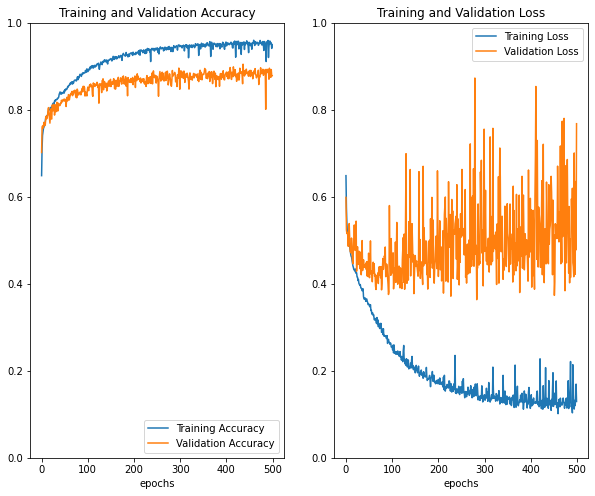

In [ ]:
# plot results
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(10, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.ylim(0, 1)
plt.ylabel('')
plt.xlabel('epochs')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.ylim(0, 1)
plt.ylabel('')
plt.xlabel('epochs')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
#plt.show()
plt.savefig('/content/drive/My Drive/CampsiteProjectFiles/500epochs_more_filters.png') 

In [12]:
y = np.concatenate([y for x, y in X_test], axis=0)

In [ ]:
y.shape

(3246,)

In [13]:
y_pred = predictions.ravel()

In [ ]:
y_pred.shape

(3246,)

In [ ]:
y_pred[:10]

array([0.9704466 , 0.703422  , 0.9033201 , 0.93416685, 0.9666663 ,
       0.81540835, 0.7426511 , 0.00688644, 0.99997187, 0.98444504],
      dtype=float32)

In [ ]:
y[:10]

array([1, 1, 1, 1, 1, 1, 1, 0, 1, 1], dtype=int32)

In [ ]:
from sklearn import metrics
fpr_keras, tpr_keras, thresholds_keras = metrics.roc_curve(y, y_pred)
auc_keras = metrics.auc(fpr_keras, tpr_keras)

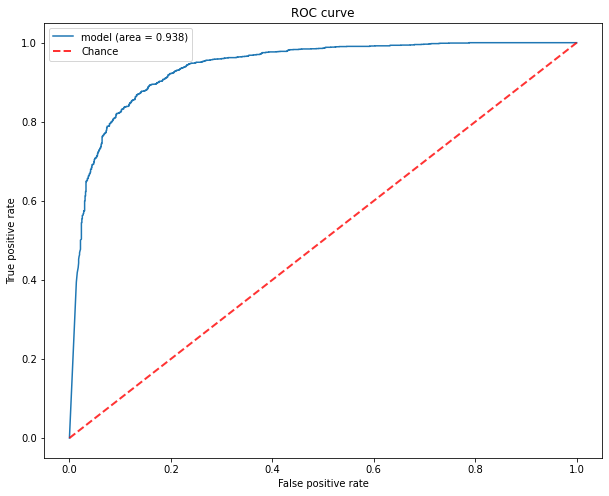

In [ ]:
# https://www.dlology.com/blog/simple-guide-on-how-to-generate-roc-plot-for-keras-classifier/
fig, ax = plt.subplots(1, figsize=(10, 8))
ax.plot(fpr_keras, tpr_keras, label='model (area = {:.3f})'.format(auc_keras))
ax.plot([0, 1], [0, 1], linestyle='--', lw=2, color='r', label='Chance', alpha=.8)
ax.set_xlabel('False positive rate')
ax.set_ylabel('True positive rate')
ax.set_title('ROC curve')
plt.legend(loc='best')
#plt.show()
plt.savefig('/content/drive/My Drive/CampsiteProjectFiles/ROC_500epochs.png') 

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
def compute_plot_confusion_matrix(y_true_class, y_pred_class, classes):
    confmat = confusion_matrix(y_true_class, y_pred_class, labels=range(2))
    confmat = confmat / confmat.sum(0).astype(float)
    df_cm = pd.DataFrame(confmat, columns = classes)
    plt.figure(figsize = (12,10))
    sns.heatmap(df_cm, annot=True, fmt=".2f")
    return confmat

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [ ]:
confmat = confusion_matrix(y, predictions_binary)

In [ ]:
confmat

array([[ 805,  298],
       [  96, 2047]])

In [ ]:
confmat / confmat.sum(0).astype(float)

array([[0.89345172, 0.12707889],
       [0.10654828, 0.87292111]])

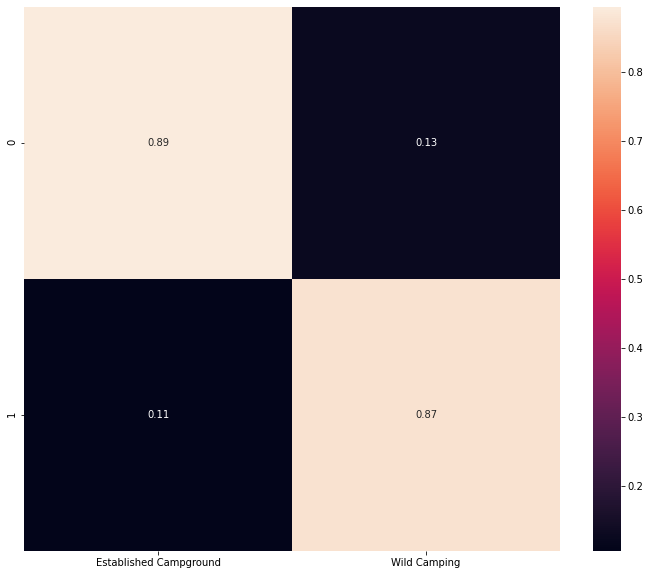

In [ ]:
compute_plot_confusion_matrix(y, predictions_binary, ['Established Campground', 'Wild Camping'])
plt.savefig('confusion_matrix_500_epochs.png')

In [ ]:
# save model
# model.save('/content/drive/My Drive/TF_models/500_epochs_model_wild_est_binary')

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
INFO:tensorflow:Assets written to: /content/drive/My Drive/TF_models/500_epochs_model_wild_est_binary/assets


In [ ]:
# check some images where predictions were wrong
y.shape

(3246,)

In [14]:
predictions_binary_vec = predictions_binary.reshape(-1,)

In [ ]:
predictions_binary_vec.shape

(3246,)

In [ ]:
#y.eval(feed_dict={x: X_test})

In [15]:
# does this give me X test images?
x_test_images = np.concatenate([x for x, y in X_test], axis=0)

In [ ]:
x_test_images.shape

(3246, 256, 256, 3)

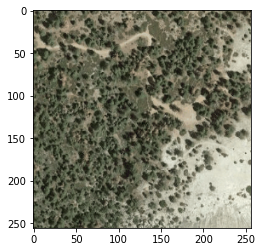

In [ ]:
plt.imshow(x_test_images[0].astype("uint8"))

In [16]:
# ok combine them when predictions are wrong?
ys = np.column_stack((predictions_binary_vec, y))

In [20]:
y_predictions_df = pd.DataFrame(ys, columns=['predict', 'actual'])
y_predictions_df

,predict,actual
0,1,1
1,1,1
2,0,1
3,1,1
4,1,1
...,...,...
3241,1,1
3242,1,1
3243,1,1
3244,0,0


In [23]:
y_predictions_df = y_predictions_df.replace(to_replace=0, value="est_camp") #['Established Campground', 'Wild Camping']

In [24]:
y_predictions_df = y_predictions_df.replace(to_replace=1, value="wild_camp") #['Established Campground', 'Wild Camping']

In [26]:
x_test_images.shape

(3246, 256, 256, 3)

In [29]:
one_img = x_test_images[1,]
one_img.shape

(256, 256, 3)

In [31]:
# create pandas series first
images = pd.Series(list(x_test_images))

In [36]:
images[0].shape

(256, 256, 3)

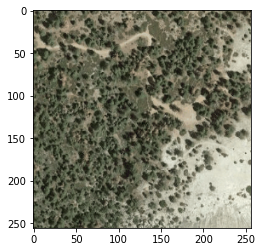

In [37]:
plt.imshow(images[0].astype("uint8"))

In [38]:
y_predictions_df['image'] = images

In [39]:
y_predictions_df.head()

,predict,actual,image
0,wild_camp,wild_camp,"[[[110.21907, 108.87009, 91.01953], [141.57895..."
1,wild_camp,wild_camp,"[[[109.734375, 105.734375, 93.59955], [113.0, ..."
2,est_camp,wild_camp,"[[[224.38672, 224.38672, 223.40625], [214.3156..."
3,wild_camp,wild_camp,"[[[139.20312, 120.01953, 102.01953], [150.3382..."
4,wild_camp,wild_camp,"[[[41.412857, 42.678925, 30.896667], [20.51768..."


In [48]:
wrong_imgs = y_predictions_df[y_predictions_df['predict'] != y_predictions_df['actual']]

In [69]:
# save this
wrong_imgs.to_csv('/content/drive/My Drive/CampsiteProjectFiles/wrong_imgs_500epoch_model.csv')

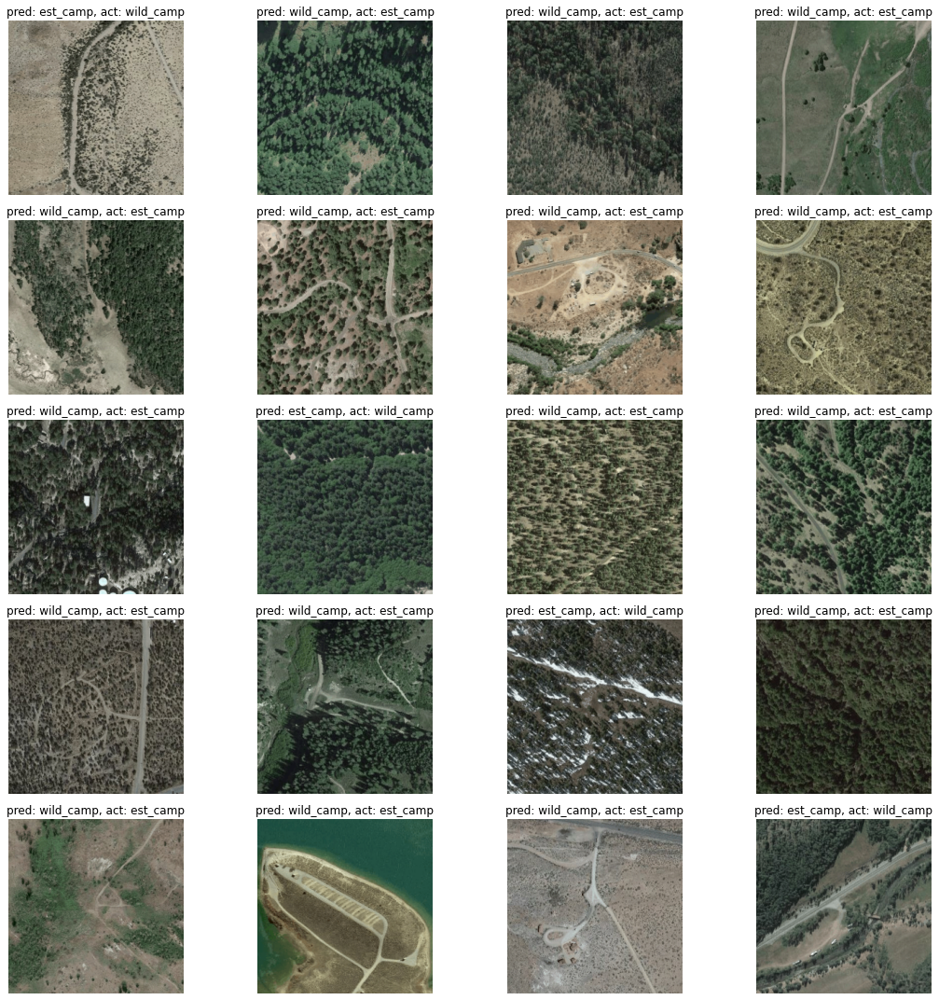

In [68]:
# plot some
from random import choices
num_samples = 20
samples = choices(range(len(wrong_imgs)), k=num_samples)

fig, axs = plt.subplots(int(num_samples/4), 4, figsize=(15,15))

for i, ax in zip(samples, axs.flatten()):
  # print(i)
#   #print(ax[i,0])
  img = wrong_imgs.iloc[i]['image'].astype("uint8")
  pred = wrong_imgs.iloc[i]['predict']
  act = wrong_imgs.iloc[i]['actual']
  ax.imshow(img)
  ax.set_title(f'pred: {pred}, act: {act}')
  ax.axis('off')
plt.tight_layout();


In [47]:
test.shape

(394, 3)

In [17]:
ys.shape

(3246, 2)

In [ ]:
ys[:,0] == ys[:,1]

array([ True,  True,  True, ...,  True,  True,  True])

In [ ]:
ys_mask = ys[:,0] == ys[:,1]

In [ ]:
ys_mask.shape

(3246,)

In [ ]:
ys_mask.sum() # this is how many correct predictions should be the same as diag of confusion matrix?

2796

In [ ]:
len(ys_mask) - ys_mask.sum()

450

In [ ]:
np.diag(np.fliplr(confmat)).sum()

450

In [ ]:
wrong_imgs = x_test_images[~ys_mask,...]

In [ ]:
x_test_images.shape

(3246, 256, 256, 3)

In [ ]:
wrong_imgs.shape

(450, 256, 256, 3)

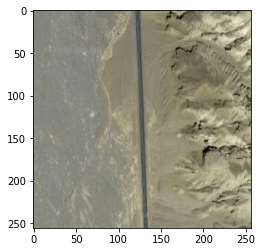

In [ ]:
plt.imshow(wrong_imgs[0].astype("uint8"))

In [ ]:
total_imgs = wrong_imgs.shape[0]
total_imgs

450

In [ ]:
cols = 5
rows = total_imgs / cols
rows

90.0

In [ ]:
cols

5

In [ ]:
img = wrong_imgs[i].astype("uint8")

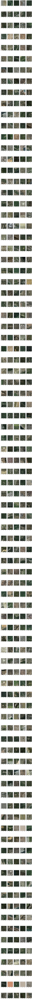

In [ ]:
fig, axs = plt.subplots(int(rows), cols, figsize=(15,500))
for i, ax in enumerate(axs.flatten()):
  #print(ax[i,0])
  img = wrong_imgs[i].astype("uint8")
  ax.imshow(img)